# Model Evaluation

In [81]:
import pandas as pd

Overview of the metrics used to evaluate the performance of the model
- R-squared
- Mean Absolute Error

The first overview is the different metrics for the amount of cameras used in the model, all the cameras are pointed 10 degrees wide in all directions. The second overview is the different metrics for the amount of degrees the cameras are pointed in all directions, the amount of cameras used is 7.
The trajectory used for the evaluation is an 8-shaped trajectory.

In [82]:
res_cams = pd.read_csv('../results/results_cams_8', decimal='.', delimiter=',')
res_degrees = pd.read_csv('../results/results_degrees', decimal='.', delimiter=',')
res_multiple_cams = pd.read_csv('../results/results_multiple_cams', decimal='.', delimiter=',')

In [83]:
from utils.plot_maker import overview_metrics

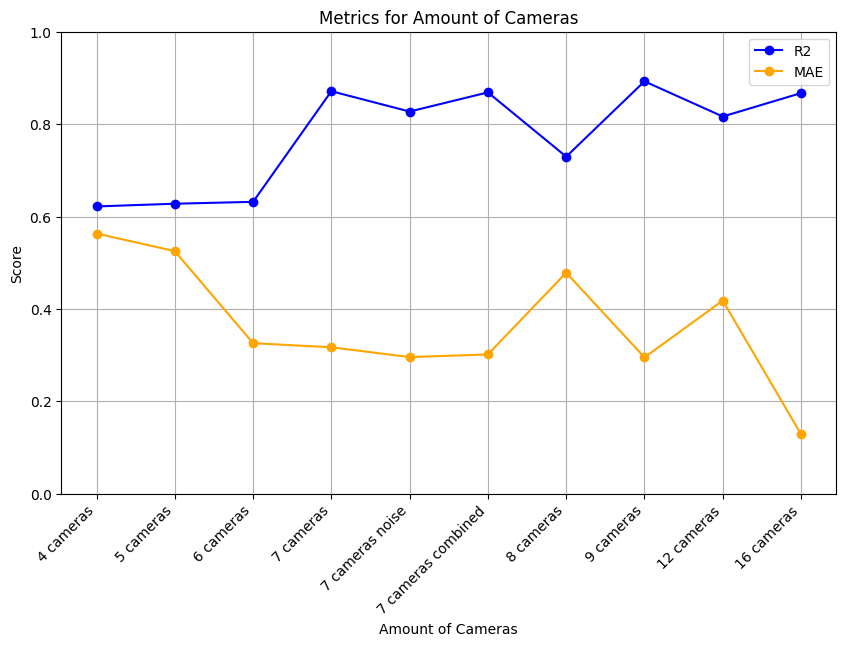

In [84]:
overview_metrics(res_cams, 'Amount of Cameras')

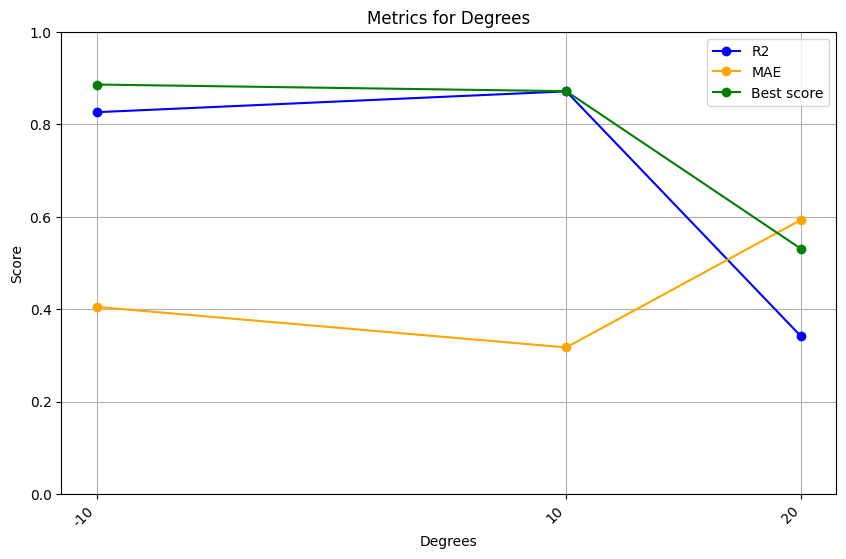

In [85]:
overview_metrics(res_degrees, 'Degrees')

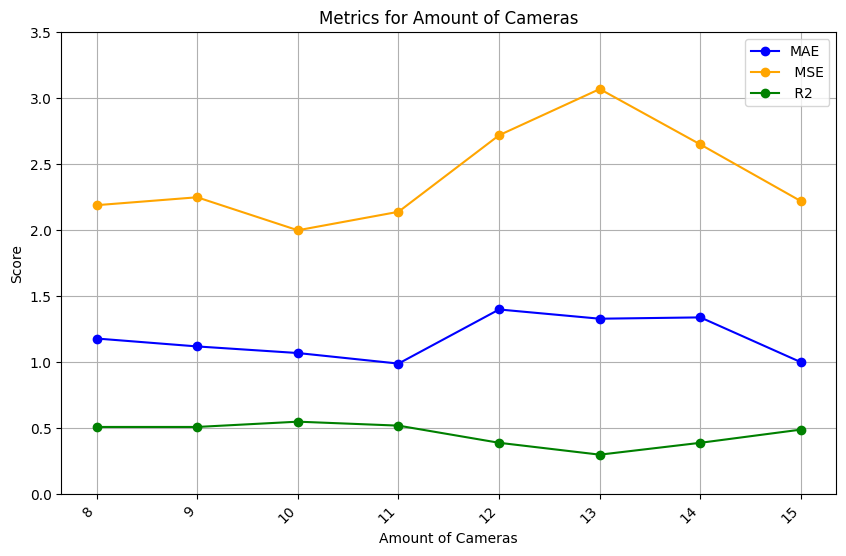

In [86]:
overview_metrics(res_multiple_cams, 'Amount of Cameras', 3.5)

In [87]:
from matplotlib import pyplot as plt

y_test = pd.read_csv('../actual.csv', delimiter=',', decimal='.').values[:400]
y_pred = pd.read_csv('../predicted.csv', delimiter=',', decimal='.').values[:400]
y_pred

array([[ 7.13488433,  3.37520323, 23.94857632],
       [ 7.17764721,  3.43300492, 24.10444222],
       [ 7.22650073,  3.58140836, 23.45700642],
       ...,
       [ 8.59378987,  5.17879633, 24.2327769 ],
       [ 8.60148984,  5.25827724, 24.49380551],
       [ 8.68205869,  5.34868843, 24.79517784]])

In [88]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots
frames_list = []

# Create a 3D scatter plot figure
fig = make_subplots(rows=1, cols=1, specs=[[{'type': 'scatter3d'}]])

# Add scatter plot for true values
fig.add_trace(go.Scatter3d(
    x=y_test[:, 0],
    y=y_test[:, 1],
    z=y_test[:, 2],
    mode='markers',
    marker=dict(
        size=5,
        color='blue',
        opacity=0.5
    ),
    name='True values'
))

# Add scatter plot for predicted values (initially empty)
fig.add_trace(go.Scatter3d(
    x=[],
    y=[],
    z=[],
    mode='markers',
    marker=dict(
        size=5,
        color='red',
        opacity=0.5
    ),
    name='Predicted values'
))

# Add scatter plot for connecting lines (initially empty)
fig.add_trace(go.Scatter3d(
    x=[],
    y=[],
    z=[],
    mode='lines',
    line=dict(
        color='red',
        width=2
    ),
    name='Predicted trajectory'
))

# Add scatter plot for true trajectory (initially empty)
fig.add_trace(go.Scatter3d(
    x=[],
    y=[],
    z=[],
    mode='lines',
    line=dict(
        color='blue',
        width=2
    ),
    name='True trajectory'
))

fig.update_layout(
    scene=dict(
        xaxis=dict(showbackground=False, showgrid=True, showline=True, linecolor='black', linewidth=2),
        yaxis=dict(showbackground=False, showgrid=True, showline=True, linecolor='black', linewidth=2),
        zaxis=dict(showbackground=False, showgrid=True, showline=True, linecolor='black', linewidth=2),
        xaxis_title='X axis',
        yaxis_title='Y axis',
        zaxis_title='Z axis',
        # set the x-axis from 0 to 20
        xaxis_range=[0, 10],
        yaxis_range=[0, 6],
        zaxis_range=[0, 26],
        # set the y-axis from 0 to 20
        aspectratio=dict(x=1, y=1, z=1),
        aspectmode='manual'
    ),
    title='True vs Predicted Values'
)

# Define the number of frames (each frame shows one point)
num_frames = len(y_test)

# Define animation frames
frames = [go.Frame(
    data=[go.Scatter3d(
        x=y_test[:i+1, 0],
        y=y_test[:i+1, 1],
        z=y_test[:i+1, 2],
        mode='markers',
        marker=dict(
            size=5,
            color='blue',
            opacity=0.5
        ),
        name='True values'
    ),
    go.Scatter3d(
        x=y_pred[:i+1, 0],
        y=y_pred[:i+1, 1],
        z=y_pred[:i+1, 2],
        mode='markers',
        marker=dict(
            size=5,
            color='red',
            opacity=0.5
        ),
        name='Predicted values'
    ),
    go.Scatter3d(
        x=y_pred[:i+1, 0],
        y=y_pred[:i+1, 1],
        z=y_pred[:i+1, 2],
        mode='lines',
        line=dict(
            color='red',
            width=4
        ),
        name='Predicted trajectory'
    ),
    go.Scatter3d(
        x=y_test[:i+1, 0],
        y=y_test[:i+1, 1],
        z=y_test[:i+1, 2],
        mode='lines',
        line=dict(
            color='blue',
            width=10
        ),
        name='True trajectory'
    )],
    name=f'frame_{i}'
) for i in range(num_frames)]

# Add frames to animation
fig.frames = frames

# Create the animation
animation = go.layout.Updatemenu(
    type='buttons',
    showactive=False,
    buttons=[dict(
        label='Play',
        method='animate',
        args=[None, dict(
            frame=dict(duration=30, redraw=True),
            fromcurrent=True,
            mode='immediate'
        )]
    )]
)

# Add animation to the layout
fig.update_layout(updatemenus=[animation])

# Show the plot
fig.show()

In [89]:
import plotly.io as pio

# Save the plot as an HTML file
pio.write_html(fig, 'animation_1.html')
